In [1]:
import numpy as np
import pandas as pd
import warnings
warnings.filterwarnings('ignore')

In [2]:
data=pd.read_csv('train-2.csv')


In [3]:
data.describe()

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,...,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
count,1460.000000,1460.000000,1201.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1452.000000,1460.000000,...,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000
mean,730.500000,56.897260,70.049958,10516.828082,6.099315,5.575342,1971.267808,1984.865753,103.685262,443.639726,...,94.244521,46.660274,21.954110,3.409589,15.060959,2.758904,43.489041,6.321918,2007.815753,180921.195890
std,421.610009,42.300571,24.284752,9981.264932,1.382997,1.112799,30.202904,20.645407,181.066207,456.098091,...,125.338794,66.256028,61.119149,29.317331,55.757415,40.177307,496.123024,2.703626,1.328095,79442.502883
min,1.000000,20.000000,21.000000,1300.000000,1.000000,1.000000,1872.000000,1950.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000,34900.000000
25%,365.750000,20.000000,59.000000,7553.500000,5.000000,5.000000,1954.000000,1967.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,2007.000000,129975.000000
50%,730.500000,50.000000,69.000000,9478.500000,6.000000,5.000000,1973.000000,1994.000000,0.000000,383.500000,...,0.000000,25.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,2008.000000,163000.000000
75%,1095.250000,70.000000,80.000000,11601.500000,7.000000,6.000000,2000.000000,2004.000000,166.000000,712.250000,...,168.000000,68.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,2009.000000,214000.000000
max,1460.000000,190.000000,313.000000,215245.000000,10.000000,9.000000,2010.000000,2010.000000,1600.000000,5644.000000,...,857.000000,547.000000,552.000000,508.000000,480.000000,738.000000,15500.000000,12.000000,2010.000000,755000.000000


In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   object 
 3   LotFrontage    1201 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   object 
 6   Alley          91 non-null     object 
 7   LotShape       1460 non-null   object 
 8   LandContour    1460 non-null   object 
 9   Utilities      1460 non-null   object 
 10  LotConfig      1460 non-null   object 
 11  LandSlope      1460 non-null   object 
 12  Neighborhood   1460 non-null   object 
 13  Condition1     1460 non-null   object 
 14  Condition2     1460 non-null   object 
 15  BldgType       1460 non-null   object 
 16  HouseStyle     1460 non-null   object 
 17  OverallQual    1460 non-null   int64  
 18  OverallC

In [5]:
to_drop=['PoolQC','Fence','MiscFeature','Alley']

In [6]:
cpdata=data.copy()

In [7]:
cpdata=cpdata.drop(to_drop,axis=1)

In [8]:
cpdata.shape

(1460, 77)

In [9]:
unique_val=[]
dtypes=[]
for col in cpdata.columns:
    unique_val.append(cpdata[col].nunique())
    dtypes.append(cpdata[col].dtype)
df = pd.DataFrame({
    'Column': cpdata.columns,
    'Unique_Count': unique_val,
    'Data Type': dtypes
})
pd.set_option('display.max_rows', data.shape[1])
print(df.sort_values('Unique_Count'))
pd.set_option('display.max_rows',50)
   


           Column  Unique_Count Data Type
5          Street             2    object
8       Utilities             2    object
40     CentralAir             2    object
64     PavedDrive             3    object
49       HalfBath             3     int64
10      LandSlope             3    object
47   BsmtHalfBath             3     int64
59   GarageFinish             3    object
55     Fireplaces             4     int64
48       FullBath             4     int64
51   KitchenAbvGr             4     int64
52    KitchenQual             4    object
24     MasVnrType             4    object
46   BsmtFullBath             4     int64
7     LandContour             4    object
6        LotShape             4    object
29       BsmtQual             4    object
30       BsmtCond             4    object
31   BsmtExposure             4    object
26      ExterQual             4    object
39      HeatingQC             5    object
41     Electrical             5    object
27      ExterCond             5   

In [10]:
category_cols = ['CentralAir', 'Street', 'Utilities', 'PavedDrive', 'BsmtHalfBath', 'HalfBath', 'LandSlope', 
                 'FullBath', 'GarageFinish', 'Fireplaces', 'LotShape', 'KitchenQual', 'KitchenAbvGr', 'LandContour',
                 'ExterQual', 'BsmtFullBath', 'ExterCond', 'BsmtQual', 'HeatingQC', 'GarageCars', 'BsmtExposure', 'MasVnrType',
                 'BldgType', 'MSZoning', 'LotConfig', 'RoofStyle', 'Foundation', 'FireplaceQu', 'SaleCondition', 
                 'GarageType', 'BsmtFinType1', 'BsmtFinType2', 'BedroomAbvGr', 'HouseStyle', 'OverallQual', 'OverallCond',
                 'SaleType', 'Condition1', 'BsmtCond', 'Heating', 'GarageQual', 'Electrical', 'GarageCond', 
                 'Functional', 'Condition2', 'RoofMatl', 'TotRmsAbvGrd', 'MoSold', 'MSSubClass', 'Exterior1st', 'Exterior2nd']
for col in category_cols:
    cpdata[col] = cpdata[col].astype('category')

In [11]:
cpdata.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 77 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   Id             1460 non-null   int64   
 1   MSSubClass     1460 non-null   category
 2   MSZoning       1460 non-null   category
 3   LotFrontage    1201 non-null   float64 
 4   LotArea        1460 non-null   int64   
 5   Street         1460 non-null   category
 6   LotShape       1460 non-null   category
 7   LandContour    1460 non-null   category
 8   Utilities      1460 non-null   category
 9   LotConfig      1460 non-null   category
 10  LandSlope      1460 non-null   category
 11  Neighborhood   1460 non-null   object  
 12  Condition1     1460 non-null   category
 13  Condition2     1460 non-null   category
 14  BldgType       1460 non-null   category
 15  HouseStyle     1460 non-null   category
 16  OverallQual    1460 non-null   category
 17  OverallCond    1460 non-null   ca

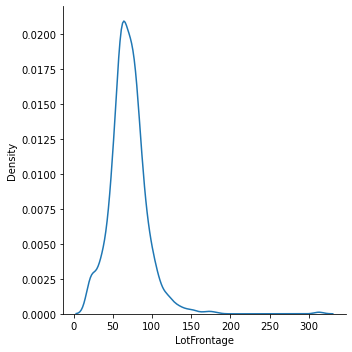

In [12]:
import seaborn as sns
sns.displot(cpdata['LotFrontage'],kind='kde')

In [13]:
cpdata.LotFrontage.fillna(60, inplace=True)

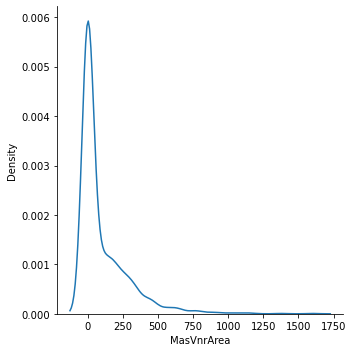

In [14]:
sns.displot(cpdata['MasVnrArea'],kind='kde')

In [15]:
cpdata.MasVnrArea.fillna(0,inplace=True)

In [16]:
cols_to_impute_notbuilt = ['MasVnrType', 'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2', 'FireplaceQu',
                          'GarageType', 'GarageFinish', 'GarageQual', 'GarageCond']

for col in cols_to_impute_notbuilt:
    if str(cpdata[col].dtypes) == 'category':
        cpdata[col].cat.add_categories('NotBuilt', inplace=True)
    cpdata[col].fillna('NotBuilt', axis=0, inplace=True)

In [17]:
cpdata.Electrical.fillna(cpdata.Electrical.mode()[0], axis=0, inplace=True)

In [18]:
import matplotlib.pyplot as plt

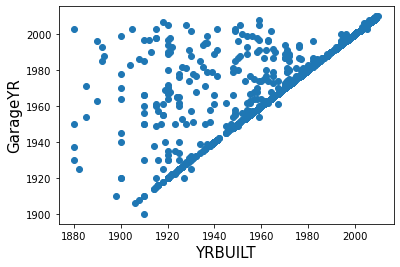

Correlation between garage built year and house built year is: 0.8


In [19]:
plt.scatter(cpdata.YearBuilt, cpdata.GarageYrBlt)
plt.xlabel('YRBUILT',fontsize=15)
plt.ylabel('GarageYR',fontsize=15)
plt.show()
print("Correlation between garage built year and house built year is:", round(cpdata.GarageYrBlt.corr(cpdata.YearBuilt), 1))

In [20]:
def fill_garage_yr(garageYr, builtYr):
    if pd.isnull(garageYr):
        return builtYr
    else:
        return garageYr
cpdata['GarageYrBlt'] = cpdata.apply(
    lambda row: fill_garage_yr(row.GarageYrBlt, row.YearBuilt),
    axis=1
)

In [21]:
def box_plot(df=cpdata):
    num_data = df.select_dtypes(include='number')
    num_cols_per_row = 5
    num_rows = int(np.ceil(len(num_data.columns)/num_cols_per_row))
    fig_num = 0
    plt.figure(figsize=(15,15))
    for col in num_data:
        fig_num += 1
        plt.subplot(num_rows, num_cols_per_row, fig_num)
        num_data[col].plot.box()
    plt.show()

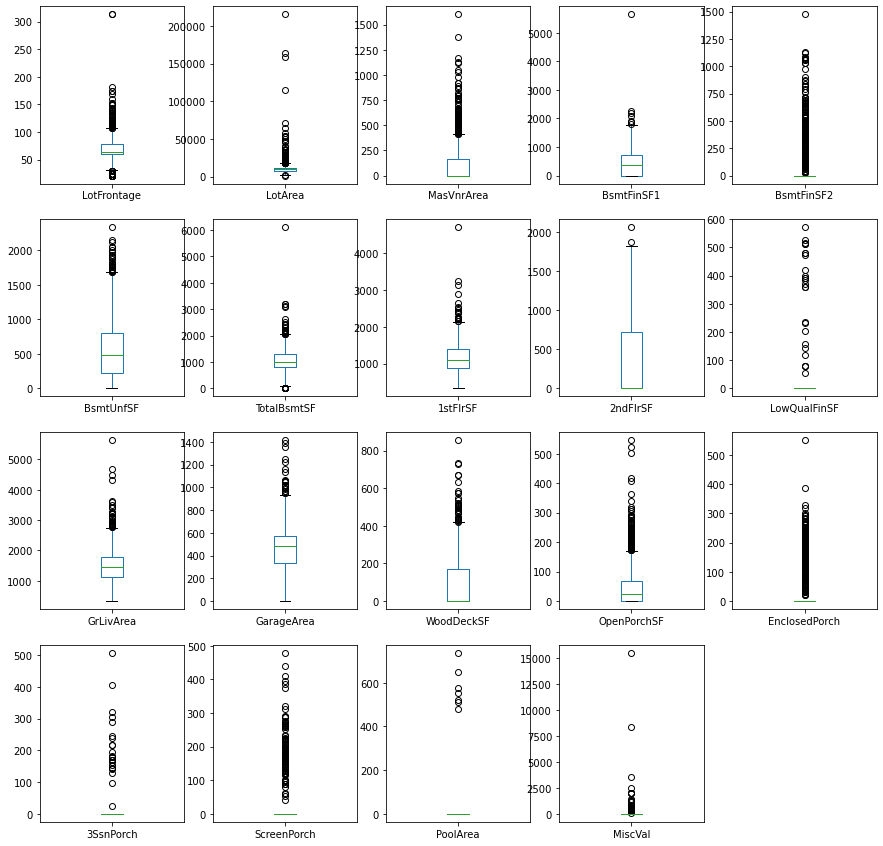

In [22]:
box_plot(cpdata.drop(['Id', 'YearBuilt', 'YearRemodAdd', 'GarageYrBlt', 'YrSold', 'SalePrice'], axis=1))

In [23]:
num_data = cpdata.select_dtypes(include='number')
lower_prcntle = 5
upper_prcntle = 100 - lower_prcntle
for num_col in num_data.columns:
    obs_within_lmts = cpdata[(cpdata[num_col] > cpdata[num_col].quantile(lower_prcntle/100)) & 
                              (cpdata[num_col] < cpdata[num_col].quantile(upper_prcntle/100))]
    print('There are {}% of observations between {}th percentile and {}th percentile for the column {}.'
          .format(round(100*obs_within_lmts.shape[0]/cpdata.shape[0], 2), lower_prcntle, upper_prcntle, num_col))

There are 90.0% of observations between 5th percentile and 95th percentile for the column Id.
There are 89.86% of observations between 5th percentile and 95th percentile for the column LotFrontage.
There are 90.0% of observations between 5th percentile and 95th percentile for the column LotArea.
There are 88.49% of observations between 5th percentile and 95th percentile for the column YearBuilt.
There are 77.88% of observations between 5th percentile and 95th percentile for the column YearRemodAdd.
There are 35.41% of observations between 5th percentile and 95th percentile for the column MasVnrArea.
There are 62.95% of observations between 5th percentile and 95th percentile for the column BsmtFinSF1.
There are 6.44% of observations between 5th percentile and 95th percentile for the column BsmtFinSF2.
There are 86.85% of observations between 5th percentile and 95th percentile for the column BsmtUnfSF.
There are 89.93% of observations between 5th percentile and 95th percentile for the co

In [24]:
c_remove=['MiscVal','ScreenPorch','3SsnPorch','BsmtFinSF2','LowQualFinSF','EnclosedPorch']

In [25]:
cpdata=cpdata.drop(cpdata[c_remove],axis=1)

In [26]:
cpdata.shape

(1460, 71)

# Managing Outliers

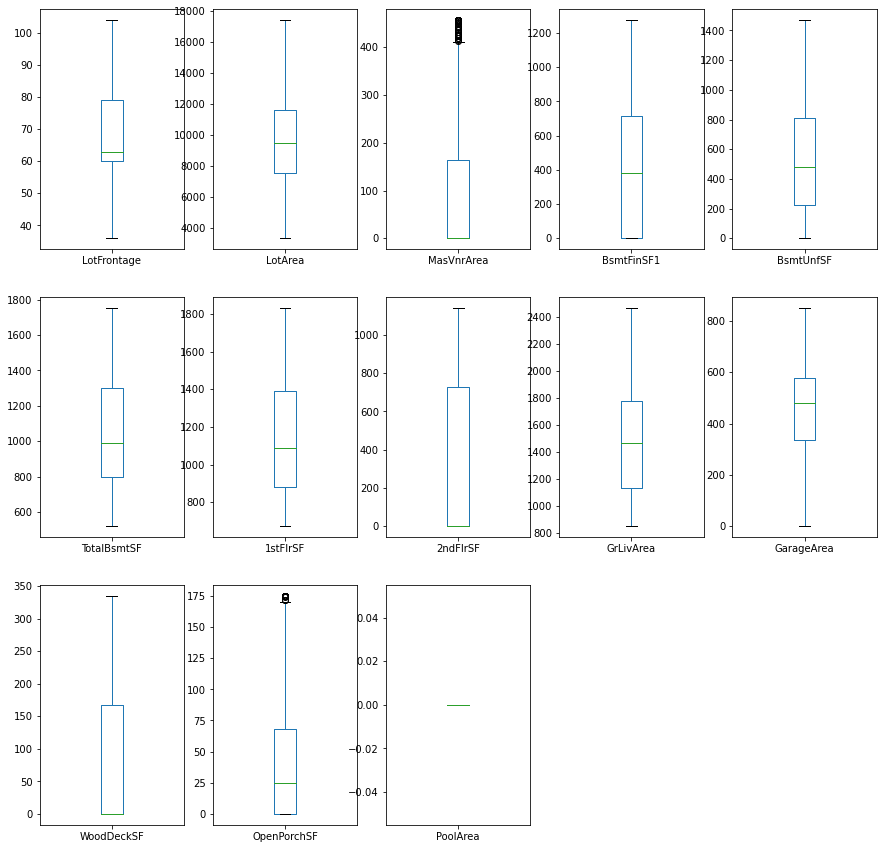

In [27]:
num_data = cpdata.select_dtypes(include='number')
num_data.drop(['Id', 'YearBuilt', 'YearRemodAdd', 'GarageYrBlt', 'YrSold', 'SalePrice'], axis=1, inplace=True)
treat_outliers = num_data.columns
def outliers(low, high, val):
    if val < low:
        return low
    elif val > high:
        return high
    else:
        return val

for num_col in treat_outliers:
    lower_prnctle_val = num_data[num_col].quantile(lower_prcntle/100)
    upper_prcntle_val = num_data[num_col].quantile(upper_prcntle/100)
    num_data[num_col] = num_data.apply(
        lambda row: outliers(lower_prnctle_val, upper_prcntle_val, row[num_col]),
        axis=1
    )
cpdata[num_data.columns] = num_data
box_plot(num_data)

In [28]:
cpdata.PoolArea

0       0.0
1       0.0
2       0.0
3       0.0
4       0.0
       ... 
1455    0.0
1456    0.0
1457    0.0
1458    0.0
1459    0.0
Name: PoolArea, Length: 1460, dtype: float64

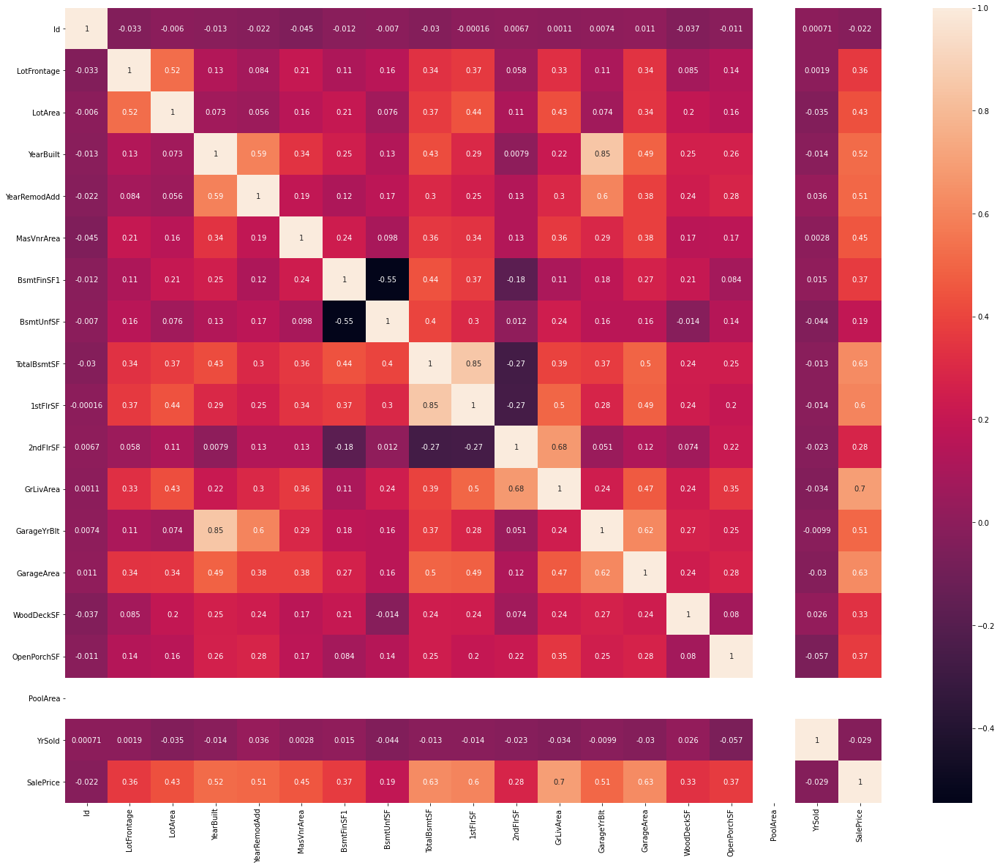

In [29]:
plt.figure(figsize=(25,20))
sns.heatmap(cpdata.corr(),annot=True)
plt.show()

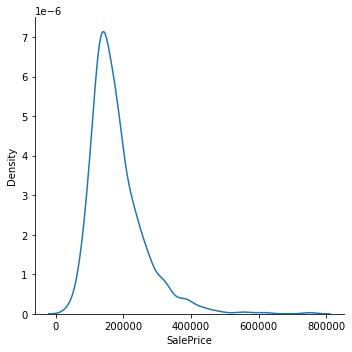

In [30]:
sns.displot(cpdata['SalePrice'],kind='kde')

Text(0.5, 6.79999999999999, 'Log Transformed Sale Price')

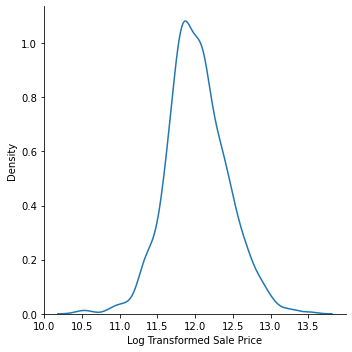

In [31]:
sns.displot(np.log(cpdata['SalePrice']),kind='kde')
plt.xlabel('Log Transformed Sale Price',fontsize=10)

In [32]:
cpdata.SalePrice = np.log(cpdata.SalePrice)

# Univariate Analysis

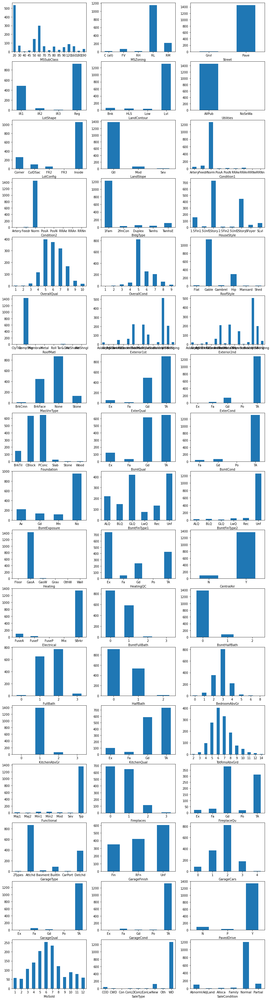

In [33]:
cat_cols =cpdata.select_dtypes(include=['category']).columns
num_cols_per_row = 3
num_rows = int(np.ceil(len(cat_cols)/num_cols_per_row))
fig_num = 0
plt.figure(figsize=(15,60))
for col in cat_cols:
    fig_num += 1
    plt.subplot(num_rows, num_cols_per_row, fig_num)
    data[col].value_counts().sort_index().plot.bar()
    plt.xlabel(col)
    plt.xticks(rotation=0)
plt.show()

# Bivariate Analysis

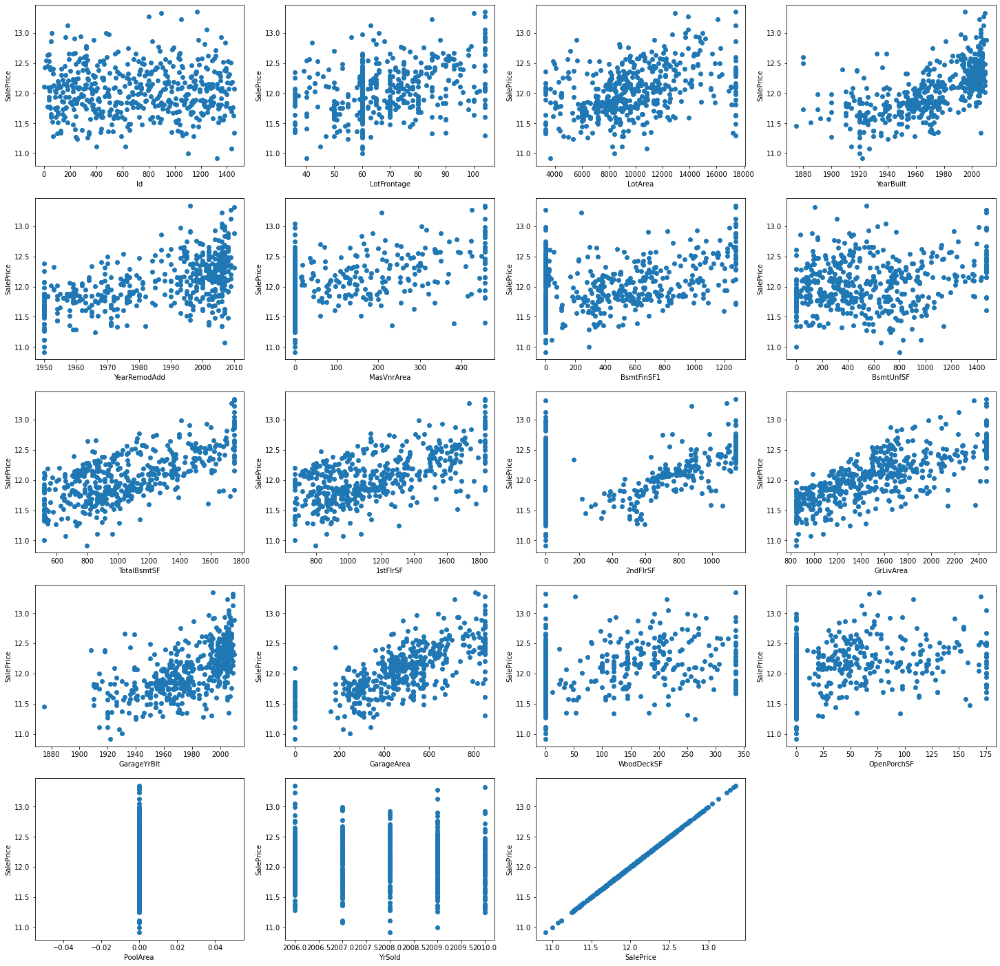

In [34]:
num_data = cpdata.select_dtypes(include='number').sample(500)
num_cols_per_row = 4
num_rows = int(np.ceil(len(num_data.columns)/num_cols_per_row))
fig_num = 0

plt.figure(figsize=(25,25))
for col in num_data:
    fig_num += 1
    plt.subplot(num_rows, num_cols_per_row, fig_num)
    plt.scatter(num_data[col], num_data['SalePrice'])
    plt.xlabel(col)
    plt.ylabel('SalePrice')
plt.show()


In [35]:
#RERLATION BETWEEN AGE AND SALE PRICE

In [36]:
cpdata.Age=cpdata.YrSold-cpdata.YearBuilt
cpdata.GarageAge=cpdata.YrSold - cpdata.GarageYrBlt

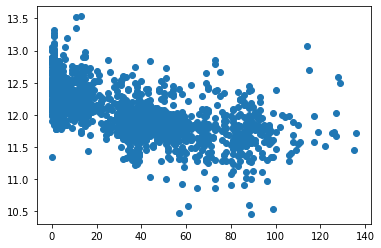

In [37]:
plt.scatter(cpdata.Age,cpdata.SalePrice)

In [38]:
y=cpdata.SalePrice
x=cpdata.Age


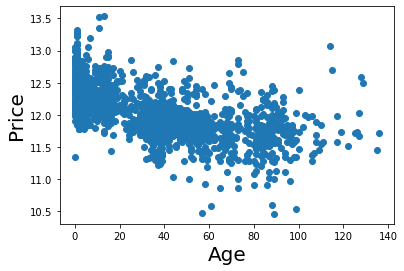

In [39]:
plt.scatter(x,y)

plt.xlabel('Age',fontsize=20)
plt.ylabel('Price',fontsize=20)
plt.show()

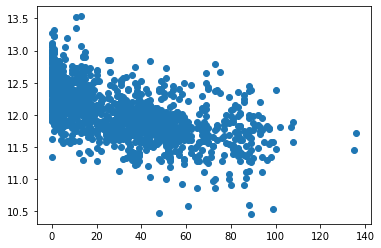

In [40]:
plt.scatter(cpdata.GarageAge,cpdata.SalePrice)

Text(0.5, 0, 'Age since Remodel')

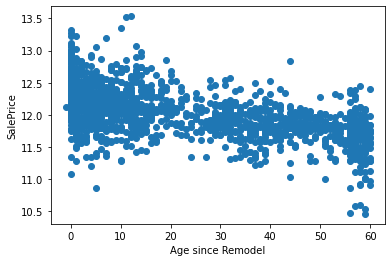

In [41]:
cpdata.AgeRemodel=cpdata.YrSold-cpdata.YearRemodAdd
plt.scatter(cpdata.AgeRemodel,cpdata.SalePrice)
plt.ylabel('SalePrice')
plt.xlabel('Age since Remodel')

In [42]:
cpdata['Neighborhood'].unique()

array(['CollgCr', 'Veenker', 'Crawfor', 'NoRidge', 'Mitchel', 'Somerst',
       'NWAmes', 'OldTown', 'BrkSide', 'Sawyer', 'NridgHt', 'NAmes',
       'SawyerW', 'IDOTRR', 'MeadowV', 'Edwards', 'Timber', 'Gilbert',
       'StoneBr', 'ClearCr', 'NPkVill', 'Blmngtn', 'BrDale', 'SWISU',
       'Blueste'], dtype=object)

In [43]:
#Categorical data which is described in numeric form can be mapped on the basis 
#of quality level.

In [44]:
def quality_rating(x):
    if x <= 3:
        return 0
    elif x <= 6:
        return 1
    else:
        return 2

cpdata['OverallQual'] = cpdata.OverallQual.apply(quality_rating).astype('category')
cpdata['OverallCond'] = cpdata.OverallCond.apply(quality_rating).astype('category')
cpdata['BedroomAbvGr'] = cpdata.BedroomAbvGr.apply(quality_rating).astype('category')

In [45]:
qual_cols=['ExterQual','ExterCond','BsmtQual','BsmtCond','BsmtExposure','HeatingQC','KitchenQual','FireplaceQu','GarageQual','GarageCond']


In [46]:
for col in qual_cols:
    cpdata[col]=cpdata[col].map({'NotBuilt': 0, 'Po': 1, 'Fa': 1, 'TA': 2, 'Gd': 3, 'Ex': 3}).astype('category')

In [47]:
cpdata

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,...,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,PoolArea,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450.0,Pave,Reg,Lvl,AllPub,Inside,...,2,Y,0.0,61.0,0.0,2,2008,WD,Normal,12.247694
1,2,20,RL,80.0,9600.0,Pave,Reg,Lvl,AllPub,FR2,...,2,Y,298.0,0.0,0.0,5,2007,WD,Normal,12.109011
2,3,60,RL,68.0,11250.0,Pave,IR1,Lvl,AllPub,Inside,...,2,Y,0.0,42.0,0.0,9,2008,WD,Normal,12.317167
3,4,70,RL,60.0,9550.0,Pave,IR1,Lvl,AllPub,Corner,...,2,Y,0.0,35.0,0.0,2,2006,WD,Abnorml,11.849398
4,5,60,RL,84.0,14260.0,Pave,IR1,Lvl,AllPub,FR2,...,2,Y,192.0,84.0,0.0,12,2008,WD,Normal,12.429216
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1455,1456,60,RL,62.0,7917.0,Pave,Reg,Lvl,AllPub,Inside,...,2,Y,0.0,40.0,0.0,8,2007,WD,Normal,12.072541
1456,1457,20,RL,85.0,13175.0,Pave,Reg,Lvl,AllPub,Inside,...,2,Y,335.0,0.0,0.0,2,2010,WD,Normal,12.254863
1457,1458,70,RL,66.0,9042.0,Pave,Reg,Lvl,AllPub,Inside,...,2,Y,0.0,60.0,0.0,5,2010,WD,Normal,12.493130
1458,1459,20,RL,68.0,9717.0,Pave,Reg,Lvl,AllPub,Inside,...,2,Y,335.0,0.0,0.0,4,2010,WD,Normal,11.864462


In [48]:
def get_room_grade_lvl(x):
    if x <= 5:
        return 0
    elif x <= 8:
        return 1
    else:
        return 2
cpdata['TotRmsAbvGrd'] = data.TotRmsAbvGrd.apply(get_room_grade_lvl).astype('category')

In [49]:
cpdata.Street.unique()

['Pave', 'Grvl']
Categories (2, object): ['Pave', 'Grvl']

In [50]:
cpdata.Functional.unique()

['Typ', 'Min1', 'Maj1', 'Min2', 'Mod', 'Maj2', 'Sev']
Categories (7, object): ['Typ', 'Min1', 'Maj1', 'Min2', 'Mod', 'Maj2', 'Sev']

In [51]:
cpdata.Street=cpdata.Street.map({'Grvl':0,'Pave':1})
cpdata.LandContour=cpdata.LandContour.map({'Lvl':1,'Bnk':0,'HLS':0,'Low':0})
cpdata.Utilities=cpdata.Utilities.map({'AllPub':1,'NoSeWa':0})
cpdata.LotConfig=cpdata.LotConfig.map({'Corner':1, 'CulDSac':0, 'FR2':0, 'FR3':0, 'Inside':2})
cpdata.LandSlope=cpdata.LandSlope.map({'Gtl':0, 'Mod':1, 'Sev':1})
cpdata.Condition2=cpdata.Condition2.map({'Artery':0, 'Feedr':0, 'Norm':1, 'PosA':0, 'PosN':0, 'RRAe':0, 'RRAn':0, 'RRNn':1})
cpdata.RoofMatl=cpdata.RoofMatl.map({'CompShg':1, 'WdShngl':0, 'Metal':0, 'WdShake':0, 'Membran':0, 'Tar&Grv':0, 'Roll':0, 'ClyTile':0})
cpdata.Heating=cpdata.Heating.map({'GasA':1, 'GasW':0, 'Grav':0, 'Wall':0, 'OthW':0, 'Floor':0})
cpdata.PavedDrive=cpdata.PavedDrive.map({'Y':1, 'N':0, 'P':0})
cpdata.CentralAir=cpdata.CentralAir.map({'Y':1,'N':0})
cpdata.Electrical=cpdata.Electrical.map({'SBrkr':0, 'FuseF':1, 'FuseA':1, 'FuseP':1, 'Mix':1})
cpdata.Functional=cpdata.Functional.map({'Typ':0, 'Min1':1, 'Maj1':1, 'Min2':1, 'Mod':1, 'Maj2':1,'Sev':1})
cpdata

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,...,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,PoolArea,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450.0,1,Reg,1,1,2,...,2,1,0.0,61.0,0.0,2,2008,WD,Normal,12.247694
1,2,20,RL,80.0,9600.0,1,Reg,1,1,0,...,2,1,298.0,0.0,0.0,5,2007,WD,Normal,12.109011
2,3,60,RL,68.0,11250.0,1,IR1,1,1,2,...,2,1,0.0,42.0,0.0,9,2008,WD,Normal,12.317167
3,4,70,RL,60.0,9550.0,1,IR1,1,1,1,...,2,1,0.0,35.0,0.0,2,2006,WD,Abnorml,11.849398
4,5,60,RL,84.0,14260.0,1,IR1,1,1,0,...,2,1,192.0,84.0,0.0,12,2008,WD,Normal,12.429216
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1455,1456,60,RL,62.0,7917.0,1,Reg,1,1,2,...,2,1,0.0,40.0,0.0,8,2007,WD,Normal,12.072541
1456,1457,20,RL,85.0,13175.0,1,Reg,1,1,2,...,2,1,335.0,0.0,0.0,2,2010,WD,Normal,12.254863
1457,1458,70,RL,66.0,9042.0,1,Reg,1,1,2,...,2,1,0.0,60.0,0.0,5,2010,WD,Normal,12.493130
1458,1459,20,RL,68.0,9717.0,1,Reg,1,1,2,...,2,1,335.0,0.0,0.0,4,2010,WD,Normal,11.864462


In [52]:
dummy_cols = ['MSZoning', 'LotShape', 'LotConfig', 'Condition1', 'BldgType', 'HouseStyle', 'RoofStyle', 'Exterior1st',
             'Exterior2nd', 'MasVnrType', 'Foundation', 'BsmtFinType1', 'BsmtFinType2', 'TotRmsAbvGrd', 'GarageType',
             'GarageFinish', 'SaleType', 'SaleCondition']
cpdata = pd.get_dummies(data=cpdata, columns=dummy_cols)

In [53]:
from sklearn.model_selection import train_test_split

In [54]:
inputs= cpdata.drop(['Id', 'SalePrice','Neighborhood','BsmtExposure','PoolArea'], axis=1)
target = cpdata.SalePrice
x_train, x_test, y_train, y_test = train_test_split(inputs,target, train_size=0.8, random_state=42)

In [55]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()

In [56]:
cols_to_scale = ['MSSubClass', 'LotFrontage', 'LotArea', 'OverallQual', 'OverallCond', 'MasVnrArea', 'ExterQual',
                 'ExterCond', 'BsmtQual', 'BsmtFinSF1', 'BsmtUnfSF', 'TotalBsmtSF', 'HeatingQC', '1stFlrSF',
                 '2ndFlrSF', 'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath', 'BedroomAbvGr', 'KitchenQual', 'Fireplaces',
                 'FireplaceQu', 'GarageCars', 'GarageArea', 'WoodDeckSF', 'OpenPorchSF', 'MoSold', 'YrSold',
                 ]
x_train[cols_to_scale] = scaler.fit_transform(x_train[cols_to_scale])
x_test[cols_to_scale]=scaler.transform(x_test[cols_to_scale])

In [57]:
x_train.shape

(1168, 173)

In [58]:
x_train.describe()


,MSSubClass,LotFrontage,LotArea,LandContour,LandSlope,Condition2,OverallQual,OverallCond,YearBuilt,YearRemodAdd,...,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_Abnorml,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal,SaleCondition_Partial
count,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,...,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000
mean,0.216761,0.464626,0.457177,0.906678,0.051370,0.991438,0.681079,0.592038,1970.965753,1984.897260,...,0.003425,0.083048,0.001712,0.866438,0.065925,0.003425,0.005993,0.015411,0.825342,0.083904
std,0.250187,0.249043,0.245449,0.291008,0.220846,0.092172,0.256788,0.217794,30.675495,20.733955,...,0.058445,0.276073,0.041363,0.340326,0.248257,0.058445,0.077216,0.123233,0.379837,0.277363
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1872.000000,1950.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.353417,0.303458,1.000000,0.000000,1.000000,0.500000,0.500000,1953.000000,1966.000000,...,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000
50%,0.176471,0.397502,0.446313,1.000000,0.000000,1.000000,0.500000,0.500000,1972.000000,1994.000000,...,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000
75%,0.294118,0.632623,0.595360,1.000000,0.000000,1.000000,1.000000,0.500000,2001.000000,2004.000000,...,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,2010.000000,2010.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


# Logistic Regression

In [59]:
y=x_train.isnull().sum()
pd.set_option('display.max_rows', None)
y

MSSubClass               0
LotFrontage              0
LotArea                  0
Street                   0
LandContour              0
Utilities                0
LandSlope                0
Condition2               0
OverallQual              0
OverallCond              0
YearBuilt                0
YearRemodAdd             0
RoofMatl                 0
MasVnrArea               0
ExterQual                0
ExterCond                0
BsmtQual                 0
BsmtCond                 0
BsmtFinSF1               0
BsmtUnfSF                0
TotalBsmtSF              0
Heating                  0
HeatingQC                0
CentralAir               0
Electrical               0
1stFlrSF                 0
2ndFlrSF                 0
GrLivArea                0
BsmtFullBath             0
BsmtHalfBath             0
FullBath                 0
HalfBath                 0
BedroomAbvGr             0
KitchenAbvGr             0
KitchenQual              0
Functional               0
Fireplaces               0
F

# Linear Model

In [60]:
from sklearn.linear_model import LinearRegression,Lasso,Ridge
linear_model=LinearRegression()

In [61]:
linear_model.fit(x_train,y_train)

LinearRegression()

In [62]:
linear_model.score(x_train,y_train)

0.9078802780791051

In [63]:
linear_model.score(x_test,y_test)

-27208398555468.63

In [64]:
#This relation shows that this model is overfitted so we will try different methods.

# Lasso Model

In [65]:
lasso_model = Lasso(alpha=0.0001)
lasso_model.fit(x_train, y_train)

Lasso(alpha=0.0001)

In [66]:
lasso_model.score(x_train,y_train)


0.9065342012018823

In [67]:
lasso_model.score(x_test,y_test)

0.8957089607414969

# Ridge Model

In [68]:
ridge_model = Ridge(alpha=1)

In [69]:
ridge_model.fit(x_train,y_train)

Ridge(alpha=1)

In [70]:
ridge_model.score(x_train,y_train)

0.9071653923365508

In [71]:
ridge_model.score(x_test,y_test)

0.8910457577187803

In [72]:
#Lasso model is better then ridge and linear

In [73]:
coeff_df = pd.DataFrame(columns=['Linear', 'Ridge', 'Lasso'], index=x_test.columns)
coeff_df['Linear'] = linear_model.coef_
coeff_df['Ridge'] = ridge_model.coef_
coeff_df['Lasso'] = lasso_model.coef_
pd.set_option('display.max_rows', None)
coeff_df

,Linear,Ridge,Lasso
MSSubClass,-8.097806e-02,-0.041482,-0.000000
LotFrontage,3.101305e-02,0.029538,0.028072
LotArea,1.053193e-01,0.102876,0.101400
Street,-7.393995e-02,-0.048315,-0.023360
LandContour,-1.031701e-02,-0.011579,-0.009852
Utilities,1.098761e-01,0.041152,0.000000
LandSlope,1.895230e-02,0.019216,0.022077
Condition2,7.089370e-02,0.066073,0.050821
OverallQual,1.637180e-01,0.158579,0.161027
OverallCond,1.930736e-01,0.186739,0.189854


# Test Data

In [74]:
test=pd.read_csv('test.csv')

In [75]:
test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1459 entries, 0 to 1458
Data columns (total 80 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1459 non-null   int64  
 1   MSSubClass     1459 non-null   int64  
 2   MSZoning       1455 non-null   object 
 3   LotFrontage    1232 non-null   float64
 4   LotArea        1459 non-null   int64  
 5   Street         1459 non-null   object 
 6   Alley          107 non-null    object 
 7   LotShape       1459 non-null   object 
 8   LandContour    1459 non-null   object 
 9   Utilities      1457 non-null   object 
 10  LotConfig      1459 non-null   object 
 11  LandSlope      1459 non-null   object 
 12  Neighborhood   1459 non-null   object 
 13  Condition1     1459 non-null   object 
 14  Condition2     1459 non-null   object 
 15  BldgType       1459 non-null   object 
 16  HouseStyle     1459 non-null   object 
 17  OverallQual    1459 non-null   int64  
 18  OverallC

In [76]:
testdata=test.copy()

In [77]:
for col in category_cols:
    testdata[col] = testdata[col].astype('category')

In [78]:
testdata.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1459 entries, 0 to 1458
Data columns (total 80 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   Id             1459 non-null   int64   
 1   MSSubClass     1459 non-null   category
 2   MSZoning       1455 non-null   category
 3   LotFrontage    1232 non-null   float64 
 4   LotArea        1459 non-null   int64   
 5   Street         1459 non-null   category
 6   Alley          107 non-null    object  
 7   LotShape       1459 non-null   category
 8   LandContour    1459 non-null   category
 9   Utilities      1457 non-null   category
 10  LotConfig      1459 non-null   category
 11  LandSlope      1459 non-null   category
 12  Neighborhood   1459 non-null   object  
 13  Condition1     1459 non-null   category
 14  Condition2     1459 non-null   category
 15  BldgType       1459 non-null   category
 16  HouseStyle     1459 non-null   category
 17  OverallQual    1459 non-null   ca

In [79]:
to_drop1=['PoolQC','MiscFeature','Fence','Alley']

In [80]:
testdata=testdata.drop(to_drop1,axis=1)

In [81]:
pd.set_option('display.max_columns', None)
testdata

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition
0,1461,20,RH,80.0,11622,Pave,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Feedr,Norm,1Fam,1Story,5,6,1961,1961,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,CBlock,TA,TA,No,Rec,468.0,LwQ,144.0,270.0,882.0,GasA,TA,Y,SBrkr,896,0,0,896,0.0,0.0,1,0,2,1,TA,5,Typ,0,NaN,Attchd,1961.0,Unf,1.0,730.0,TA,TA,Y,140,0,0,0,120,0,0,6,2010,WD,Normal
1,1462,20,RL,81.0,14267,Pave,IR1,Lvl,AllPub,Corner,Gtl,NAmes,Norm,Norm,1Fam,1Story,6,6,1958,1958,Hip,CompShg,Wd Sdng,Wd Sdng,BrkFace,108.0,TA,TA,CBlock,TA,TA,No,ALQ,923.0,Unf,0.0,406.0,1329.0,GasA,TA,Y,SBrkr,1329,0,0,1329,0.0,0.0,1,1,3,1,Gd,6,Typ,0,NaN,Attchd,1958.0,Unf,1.0,312.0,TA,TA,Y,393,36,0,0,0,0,12500,6,2010,WD,Normal
2,1463,60,RL,74.0,13830,Pave,IR1,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,5,5,1997,1998,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,PConc,Gd,TA,No,GLQ,791.0,Unf,0.0,137.0,928.0,GasA,Gd,Y,SBrkr,928,701,0,1629,0.0,0.0,2,1,3,1,TA,6,Typ,1,TA,Attchd,1997.0,Fin,2.0,482.0,TA,TA,Y,212,34,0,0,0,0,0,3,2010,WD,Normal
3,1464,60,RL,78.0,9978,Pave,IR1,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,6,1998,1998,Gable,CompShg,VinylSd,VinylSd,BrkFace,20.0,TA,TA,PConc,TA,TA,No,GLQ,602.0,Unf,0.0,324.0,926.0,GasA,Ex,Y,SBrkr,926,678,0,1604,0.0,0.0,2,1,3,1,Gd,7,Typ,1,Gd,Attchd,1998.0,Fin,2.0,470.0,TA,TA,Y,360,36,0,0,0,0,0,6,2010,WD,Normal
4,1465,120,RL,43.0,5005,Pave,IR1,HLS,AllPub,Inside,Gtl,StoneBr,Norm,Norm,TwnhsE,1Story,8,5,1992,1992,Gable,CompShg,HdBoard,HdBoard,None,0.0,Gd,TA,PConc,Gd,TA,No,ALQ,263.0,Unf,0.0,1017.0,1280.0,GasA,Ex,Y,SBrkr,1280,0,0,1280,0.0,0.0,2,0,2,1,Gd,5,Typ,0,NaN,Attchd,1992.0,RFn,2.0,506.0,TA,TA,Y,0,82,0,0,144,0,0,1,2010,WD,Normal
5,1466,60,RL,75.0,10000,Pave,IR1,Lvl,AllPub,Corner,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,5,1993,1994,Gable,CompShg,HdBoard,HdBoard,None,0.0,TA,TA,PConc,Gd,TA,No,Unf,0.0,Unf,0.0,763.0,763.0,GasA,Gd,Y,SBrkr,763,892,0,1655,0.0,0.0,2,1,3,1,TA,7,Typ,1,TA,Attchd,1993.0,Fin,2.0,440.0,TA,TA,Y,157,84,0,0,0,0,0,4,2010,WD,Normal
6,1467,20,RL,NaN,7980,Pave,IR1,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,1Story,6,7,1992,2007,Gable,CompShg,HdBoard,HdBoard,None,0.0,TA,Gd,PConc,Gd,TA,No,ALQ,935.0,Unf,0.0,233.0,1168.0,GasA,Ex,Y,SBrkr,1187,0,0,1187,1.0,0.0,2,0,3,1,TA,6,Typ,0,NaN,Attchd,1992.0,Fin,2.0,420.0,TA,TA,Y,483,21,0,0,0,0,500,3,2010,WD,Normal
7,1468,60,RL,63.0,8402,Pave,IR1,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,5,1998,1998,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,PConc,Gd,TA,No,Unf,0.0,Unf,0.0,789.0,789.0,GasA,Gd,Y,SBrkr,789,676,0,1465,0.0,0.0,2,1,3,1,TA,7,Typ,1,Gd,Attchd,1998.0,Fin,2.0,393.0,TA,TA,Y,0,75,0,0,0,0,0,5,2010,WD,Normal
8,1469,20,RL,85.0,10176,Pave,Reg,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,1Story,7,5,1990,1990,Gable,CompShg,HdBoard,HdBoard,None,0.0,TA,TA,PConc,Gd,TA,Gd,GLQ,637.0,Unf,0.0,663.0,1300.0,GasA,Gd,Y,SBrkr,1341,0,0,1341,1.0,0.0,1,1,2,1,Gd,5,Typ,1,Po,Attchd,1990.0,Unf,2.0,506.0,TA,TA,Y,192,0,0,0,0,0,0,2,2010,WD,Normal
9,1470,20,RL,70.0,8400,Pave,Reg,Lvl,AllPub,Corner,Gtl,NAmes,Norm,Norm,1Fam,1Story,4,5,1970,1970,Gable,CompShg,Plywood,Plywood,None,0.0,TA,TA,CBlock,TA,TA,No,ALQ,804.0,Rec,78.0,0.0,882.0,GasA,TA,Y,SBrkr,882,0,0,882,1.0,0.0,1,0,2,1,TA,4,Typ,0,NaN,Attchd,1970.0,Fin,2.0,525.0,TA,TA,Y,240,0,0,0,0,0,0,

In [82]:
testdata.isnull().sum()

Id                 0
MSSubClass         0
MSZoning           4
LotFrontage      227
LotArea            0
Street             0
LotShape           0
LandContour        0
Utilities          2
LotConfig          0
LandSlope          0
Neighborhood       0
Condition1         0
Condition2         0
BldgType           0
HouseStyle         0
OverallQual        0
OverallCond        0
YearBuilt          0
YearRemodAdd       0
RoofStyle          0
RoofMatl           0
Exterior1st        1
Exterior2nd        1
MasVnrType        16
MasVnrArea        15
ExterQual          0
ExterCond          0
Foundation         0
BsmtQual          44
BsmtCond          45
BsmtExposure      44
BsmtFinType1      42
BsmtFinSF1         1
BsmtFinType2      42
BsmtFinSF2         1
BsmtUnfSF          1
TotalBsmtSF        1
Heating            0
HeatingQC          0
CentralAir         0
Electrical         0
1stFlrSF           0
2ndFlrSF           0
LowQualFinSF       0
GrLivArea          0
BsmtFullBath       2
BsmtHalfBath 

In [83]:
testdata.LotFrontage.fillna(65, inplace=True)

In [84]:
testdata.Utilities.fillna('AllPub',inplace=True)

In [85]:
testdata.MSZoning.fillna('RL',inplace=True)

In [86]:
testdata.MasVnrArea.fillna(0,inplace=True)

In [87]:
for col in cols_to_impute_notbuilt:
    if str(testdata[col].dtypes) == 'category':
        testdata[col].cat.add_categories('NotBuilt', inplace=True)
    testdata[col].fillna('NotBuilt', axis=0, inplace=True)

In [88]:
testdata['GarageYrBlt'] = testdata.apply(
    lambda row: fill_garage_yr(row.GarageYrBlt, row.YearBuilt),
    axis=1
)

In [89]:
testdata.Exterior1st.fillna('VinylSd',inplace=True)

In [90]:
testdata.Exterior2nd.fillna('VinylSd',inplace=True)

In [91]:
testdata.BsmtFinSF1.fillna(438,inplace=True)

In [92]:
testdata.BsmtFinSF2.fillna(52,inplace=True)

In [93]:
testdata.BsmtUnfSF.fillna(554,inplace=True)

In [94]:
testdata.TotalBsmtSF.fillna(1046,inplace=True)

In [95]:
testdata.BsmtFullBath.fillna(0,inplace=True)

In [96]:
testdata.BsmtHalfBath.fillna(0,inplace=True)

In [97]:
testdata.KitchenQual.fillna('TA',inplace=True)

In [98]:
testdata.Functional.fillna('Typ',inplace=True)

In [99]:
testdata.GarageCars.fillna(0,inplace=True)

In [100]:
testdata.GarageArea.fillna(0,inplace=True)

In [101]:
testdata.SaleType.fillna('WD',inplace=True)

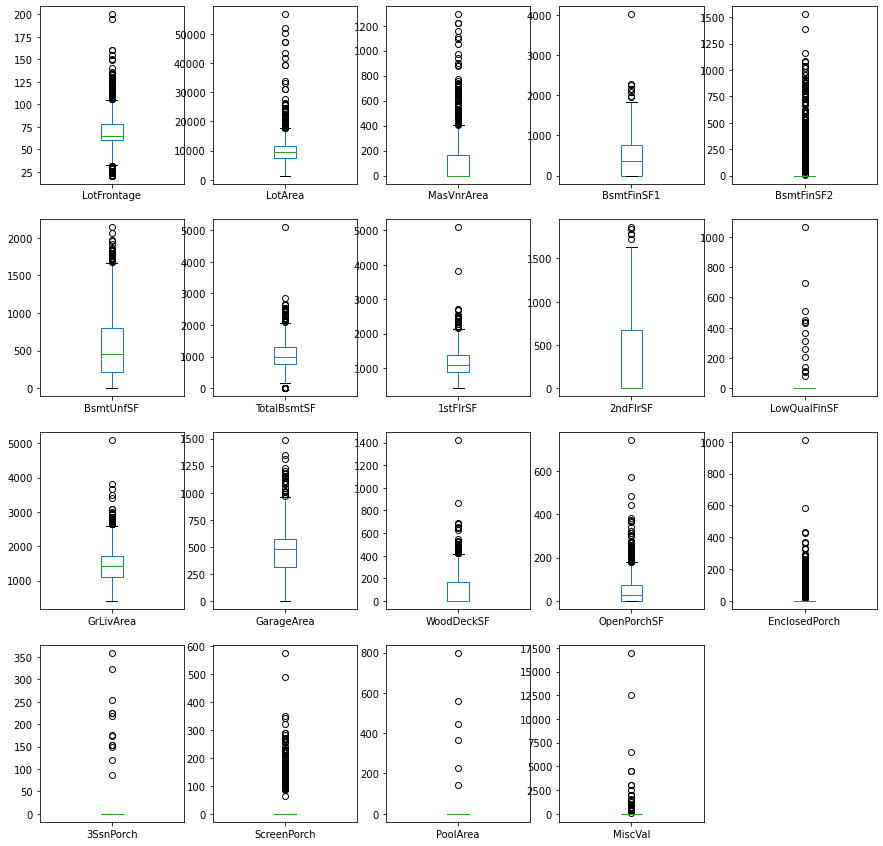

In [102]:
box_plot(testdata.drop(['Id', 'YearBuilt', 'YearRemodAdd', 'GarageYrBlt', 'YrSold'], axis=1))

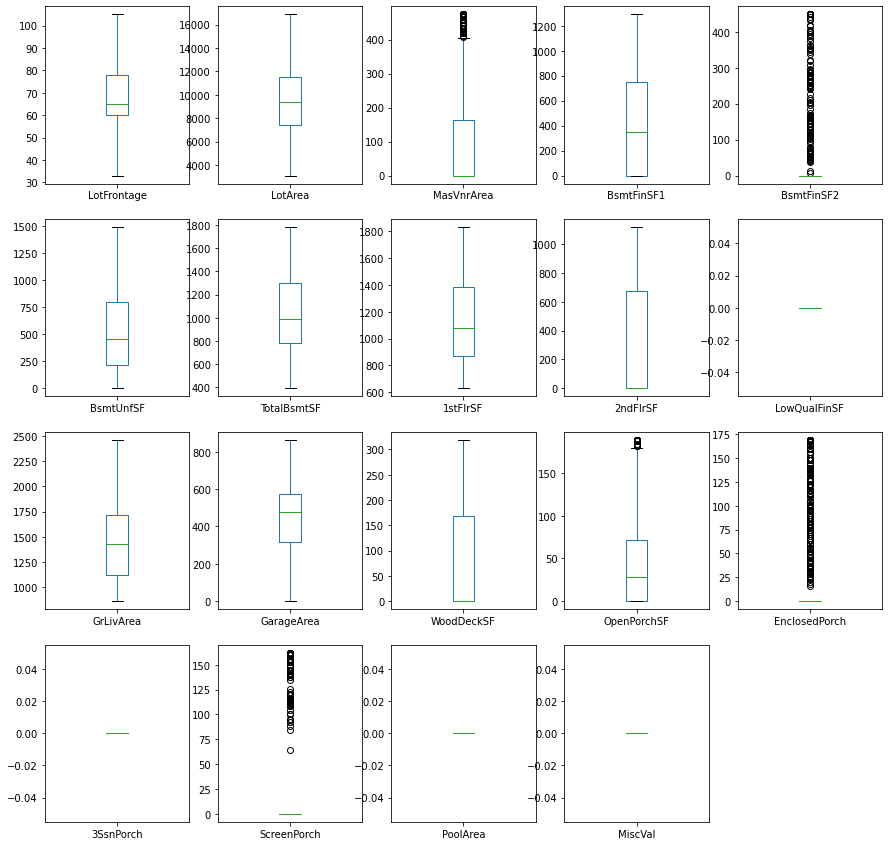

In [103]:
num_tdata = testdata.select_dtypes(include='number')
num_tdata.drop(['Id', 'YearBuilt', 'YearRemodAdd', 'GarageYrBlt', 'YrSold'], axis=1, inplace=True)
treat_outliers_test = num_tdata.columns
def outliers(low, high, val):
    if val < low:
        return low
    elif val > high:
        return high
    else:
        return val

for num_col in treat_outliers_test:
    lower_prnctle_val = num_tdata[num_col].quantile(lower_prcntle/100)
    upper_prcntle_val = num_tdata[num_col].quantile(upper_prcntle/100)
    num_tdata[num_col] = num_tdata.apply(
        lambda row: outliers(lower_prnctle_val, upper_prcntle_val, row[num_col]),
        axis=1
    )
testdata[num_tdata.columns] = num_tdata
box_plot(num_tdata)

In [104]:
testdata=testdata.drop({'LowQualFinSF','3SsnPorch','PoolArea','MiscVal'},axis=1)

In [105]:
testdata['OverallQual'] = testdata.OverallQual.apply(quality_rating).astype('category')
testdata['OverallCond'] = testdata.OverallCond.apply(quality_rating).astype('category')
testdata['BedroomAbvGr'] = testdata.BedroomAbvGr.apply(quality_rating).astype('category')

In [106]:
for col in qual_cols:
    testdata[col]=testdata[col].map({'NotBuilt': 0, 'Po': 1, 'Fa': 1, 'TA': 2, 'Gd': 3, 'Ex': 3}).astype('category')

In [107]:
testdata=testdata.drop({'BsmtExposure','Neighborhood'},axis=1)

In [108]:
testdata['TotRmsAbvGrd'] = testdata.TotRmsAbvGrd.apply(get_room_grade_lvl).astype('category')

In [109]:
testdata.Street=testdata.Street.map({'Grvl':0,'Pave':1})
testdata.LandContour=testdata.LandContour.map({'Lvl':1,'Bnk':0,'HLS':0,'Low':0})
testdata.Utilities=testdata.Utilities.map({'AllPub':1,'NoSeWa':0})
testdata.LotConfig=testdata.LotConfig.map({'Corner':1, 'CulDSac':0, 'FR2':0, 'FR3':0, 'Inside':2})
testdata.LandSlope=testdata.LandSlope.map({'Gtl':0, 'Mod':1, 'Sev':1})
testdata.Condition2=testdata.Condition2.map({'Artery':0, 'Feedr':0, 'Norm':1, 'PosA':0, 'PosN':0, 'RRAe':0, 'RRAn':0, 'RRNn':1})
testdata.RoofMatl=testdata.RoofMatl.map({'CompShg':1, 'WdShngl':0, 'Metal':0, 'WdShake':0, 'Membran':0, 'Tar&Grv':0, 'Roll':0, 'ClyTile':0})
testdata.Heating=testdata.Heating.map({'GasA':1, 'GasW':0, 'Grav':0, 'Wall':0, 'OthW':0, 'Floor':0})
testdata.PavedDrive=testdata.PavedDrive.map({'Y':1, 'N':0, 'P':0})
testdata.CentralAir=testdata.CentralAir.map({'Y':1,'N':0})
testdata.Electrical=testdata.Electrical.map({'SBrkr':0, 'FuseF':1, 'FuseA':1, 'FuseP':1, 'Mix':1})
testdata.Functional=testdata.Functional.map({'Typ':0, 'Min1':1, 'Maj1':1, 'Min2':1, 'Mod':1, 'Maj2':1,'Sev':1})

In [110]:
testdata

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,ScreenPorch,MoSold,YrSold,SaleType,SaleCondition
0,1461,20,RH,80.0,11622.0,1,Reg,1,1,2,0,Feedr,1,1Fam,1Story,1,1,1961,1961,Gable,1,VinylSd,VinylSd,None,0.0,2,2,CBlock,2,2,Rec,468.0,LwQ,144.0,270.0,882.0,1,2,1,0,896.0,0.0,896.0,0.0,0.0,1,0,0,1,2,0,0,0,0,Attchd,1961.0,Unf,1.0,730.0,2,2,1,140.0,0.0,0.0,120.0,6,2010,WD,Normal
1,1462,20,RL,81.0,14267.0,1,IR1,1,1,1,0,Norm,1,1Fam,1Story,1,1,1958,1958,Hip,1,Wd Sdng,Wd Sdng,BrkFace,108.0,2,2,CBlock,2,2,ALQ,923.0,Unf,0.0,406.0,1329.0,1,2,1,0,1329.0,0.0,1329.0,0.0,0.0,1,1,0,1,3,1,0,0,0,Attchd,1958.0,Unf,1.0,312.0,2,2,1,319.0,36.0,0.0,0.0,6,2010,WD,Normal
2,1463,60,RL,74.0,13830.0,1,IR1,1,1,2,0,Norm,1,1Fam,2Story,1,1,1997,1998,Gable,1,VinylSd,VinylSd,None,0.0,2,2,PConc,3,2,GLQ,791.0,Unf,0.0,137.0,928.0,1,3,1,0,928.0,701.0,1629.0,0.0,0.0,2,1,0,1,2,1,0,1,2,Attchd,1997.0,Fin,2.0,482.0,2,2,1,212.0,34.0,0.0,0.0,3,2010,WD,Normal
3,1464,60,RL,78.0,9978.0,1,IR1,1,1,2,0,Norm,1,1Fam,2Story,1,1,1998,1998,Gable,1,VinylSd,VinylSd,BrkFace,20.0,2,2,PConc,2,2,GLQ,602.0,Unf,0.0,324.0,926.0,1,3,1,0,926.0,678.0,1604.0,0.0,0.0,2,1,0,1,3,1,0,1,3,Attchd,1998.0,Fin,2.0,470.0,2,2,1,319.0,36.0,0.0,0.0,6,2010,WD,Normal
4,1465,120,RL,43.0,5005.0,1,IR1,0,1,2,0,Norm,1,TwnhsE,1Story,2,1,1992,1992,Gable,1,HdBoard,HdBoard,None,0.0,3,2,PConc,3,2,ALQ,263.0,Unf,0.0,1017.0,1280.0,1,3,1,0,1280.0,0.0,1280.0,0.0,0.0,2,0,0,1,3,0,0,0,0,Attchd,1992.0,RFn,2.0,506.0,2,2,1,0.0,82.0,0.0,144.0,1,2010,WD,Normal
5,1466,60,RL,75.0,10000.0,1,IR1,1,1,1,0,Norm,1,1Fam,2Story,1,1,1993,1994,Gable,1,HdBoard,HdBoard,None,0.0,2,2,PConc,3,2,Unf,0.0,Unf,0.0,763.0,763.0,1,3,1,0,763.0,892.0,1655.0,0.0,0.0,2,1,0,1,2,1,0,1,2,Attchd,1993.0,Fin,2.0,440.0,2,2,1,157.0,84.0,0.0,0.0,4,2010,WD,Normal
6,1467,20,RL,65.0,7980.0,1,IR1,1,1,2,0,Norm,1,1Fam,1Story,1,2,1992,2007,Gable,1,HdBoard,HdBoard,None,0.0,2,3,PConc,3,2,ALQ,935.0,Unf,0.0,233.0,1168.0,1,3,1,0,1187.0,0.0,1187.0,1.0,0.0,2,0,0,1,2,1,0,0,0,Attchd,1992.0,Fin,2.0,420.0,2,2,1,319.0,21.0,0.0,0.0,3,2010,WD,Normal
7,1468,60,RL,63.0,8402.0,1,IR1,1,1,2,0,Norm,1,1Fam,2Story,1,1,1998,1998,Gable,1,VinylSd,VinylSd,None,0.0,2,2,PConc,3,2,Unf,0.0,Unf,0.0,789.0,789.0,1,3,1,0,789.0,676.0,1465.0,0.0,0.0,2,1,0,1,2,1,0,1,3,Attchd,1998.0,Fin,2.0,393.0,2,2,1,0.0,75.0,0.0,0.0,5,2010,WD,Normal
8,1469,20,RL,85.0,10176.0,1,Reg,1,1,2,0,Norm,1,1Fam,1Story,2,1,1990,1990,Gable,1,HdBoard,HdBoard,None,0.0,2,2,PConc,3,2,GLQ,637.0,Unf,0.0,663.0,1300.0,1,3,1,0,1341.0,0.0,1341.0,1.0,0.0,1,1,0,1,3,0,0,1,1,Attchd,1990.0,Unf,2.0,506.0,2,2,1,192.0,0.0,0.0,0.0,2,2010,WD,Normal
9,1470,20,RL,70.0,8400.0,1,Reg,1,1,1,0,Norm,1,1Fam,1Story,1,1,1970,1970,Gable,1,Plywood,Plywood,None,0.0,2,2,CBlock,2,2,ALQ,804.0,Rec,78.0,0.0,882.0,1,2,1,0,882.0,0.0,882.0,1.0,0.0,1,0,0,1,2,0,0,0,0,Attchd,1970.0,Fin,2.0,525.0,2,2,1,240.0,0.0,0.0,0.0,4,2010,WD,Normal


In [111]:
testdata = pd.get_dummies(data=testdata, columns=dummy_cols)

In [112]:
testdata.shape

(1459, 173)

In [113]:
testdata[cols_to_scale]=scaler.transform(testdata[cols_to_scale])

In [114]:
testdata

,Id,MSSubClass,LotFrontage,LotArea,Street,LandContour,Utilities,LandSlope,Condition2,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofMatl,MasVnrArea,ExterQual,ExterCond,BsmtQual,BsmtCond,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,Functional,Fireplaces,FireplaceQu,GarageYrBlt,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,ScreenPorch,MoSold,YrSold,MSZoning_C (all),MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR1,LotShape_IR2,LotShape_IR3,LotShape_Reg,LotConfig_0,LotConfig_1,LotConfig_2,Condition1_Artery,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_PosN,Condition1_RRAe,Condition1_RRAn,Condition1_RRNe,Condition1_RRNn,BldgType_1Fam,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Fin,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,RoofStyle_Flat,RoofStyle_Gable,RoofStyle_Gambrel,RoofStyle_Hip,RoofStyle_Mansard,RoofStyle_Shed,Exterior1st_AsbShng,Exterior1st_AsphShn,Exterior1st_BrkComm,Exterior1st_BrkFace,Exterior1st_CBlock,Exterior1st_CemntBd,Exterior1st_HdBoard,Exterior1st_MetalSd,Exterior1st_Plywood,Exterior1st_Stucco,Exterior1st_VinylSd,Exterior1st_Wd Sdng,Exterior1st_WdShing,Exterior2nd_AsbShng,Exterior2nd_AsphShn,Exterior2nd_Brk Cmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_BrkCmn,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,MasVnrType_NotBuilt,Foundation_BrkTil,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtFinType1_ALQ,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Rec,BsmtFinType1_Unf,BsmtFinType1_NotBuilt,BsmtFinType2_ALQ,BsmtFinType2_BLQ,BsmtFinType2_GLQ,BsmtFinType2_LwQ,BsmtFinType2_Rec,BsmtFinType2_Unf,BsmtFinType2_NotBuilt,TotRmsAbvGrd_0,TotRmsAbvGrd_1,TotRmsAbvGrd_2,GarageType_2Types,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageType_NotBuilt,GarageFinish_Fin,GarageFinish_RFn,GarageFinish_Unf,GarageFinish_NotBuilt,SaleType_COD,SaleType_CWD,SaleType_Con,SaleType_ConLD,SaleType_ConLI,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_Abnorml,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal,SaleCondition_Partial
0,1461,0.000000,0.647318,0.589824,1,1,1,0,1,0.5,0.5,1961,1961,1,0.000000,0.5,0.5,0.666667,2,0.367347,144.0,0.183924,0.293994,1,0.5,1,0,0.192567,0.000000,0.029664,0.000000,0.0,0.333333,0.0,0.0,1,0.5,0,0.000000,0.000000,1961.0,0.25,0.858723,2,2,1,0.417910,0.000000,0.0,120.0,0.454545,1.00,0,0,1,0,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0
1,1462,0.000000,0.662013,0.777553,1,1,1,0,1,0.5,0.5,1958,1958,1,0.236842,0.5,0.5,0.666667,2,0.724490,0.0,0.276567,0.656318,1,0.5,1,0,0.566390,0.000000,0.297262,0.000000,0.0,0.333333,0.5,0.0,1,1.0,0,0.000000,0.000000,1958.0,0.25,0.367016,2,2,1,0.952239,0.205656,0.0,0.0,0.454545,1.00,0,0,0,1,0,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0
2,1463,0.235294,0.559148,0.746537,1,1,1,0,1,0.5,0.5,1997,1998,1,0.000000,0.5,0.5,1.000000,2,0.620879,0.0,0.093324,0.331280,1,1.0,1,0,0.220193,0.614346,0.482665,0.000000,0.0,0.666667,0.5,0.0,1,0.5,0,0.333333,0.666667,1997.0,0.50,0.566992,2,2,1,0.632836,0.194230,0.0,0.0,0.181818,1.00,0,0,0,1,0,1,0,0,0,0,0,1,

In [115]:
inputs1=testdata.drop('Id',axis=1)

In [116]:
testdata.shape

(1459, 173)

In [118]:
y_pred=lasso_model.predict(testdata)

In [123]:
y_final_pred= np.exp(y_pred

In [125]:
submission = pd.DataFrame()
submission['Id'] = testdata['Id']
submission['SalePrice'] = y_final_pred
submission.head()

,Id,SalePrice
0,1461,4.450373e+80
1,1462,2.139526e+61
2,1463,2.876324e+62
3,1464,3.377522e+62
4,1465,1.819485e+65


In [122]:
submission.to_csv('Saleprice_submit.csv', index = False)